Preliminaries for .toml files -> per DA, may no longer be necessary

In [ ]:
cd("../TestDrive")

In [1]:
] activate .

Main file 

In [2]:
include("src/TestDrive.jl")

┌ Warning: On Windows, creating file symlinks requires Administrator privileges
└ @ Base.Filesystem file.jl:794


population_model (generic function with 1 method)

In [3]:
using Plots
gr()
; 

Testing SIT construct 

In [4]:
# Fake migration
migrate1 = rand((6*(4+8+6+1+6)), 2, 2) 
migrate2 = rand((6*(4+8+6+1+6)), 2, 2)

firstnode = :FirstNode
secondnode = :SecondNode

example_nodes = [Node(:FirstNode, genetics_sit, stages_aedes, temp_none, (37.87, 122.27), migrate1),
    Node(:SecondNode, genetics_sit, stages_aedes, temp_none, (35.87, 120.27), migrate2)]

example_network = Network(example_nodes, 150)
;

In [5]:
# Initialize with wildtype (index 3 in this construct)
u0 = init_node!(example_nodes[1], 3)
;

In [6]:
# Skip equilibrium demo, right to ODE with CONTROLS
tspan = (0.0,300.0) 
controls = [0.0]

# Construct ODE control problem 
control_model = diffeq.ODEProblem(population_model_node, u0, tspan, (example_nodes[1], controls))

ODEProblem with uType Array{Float64,2} and tType Float64. In-place: true
timespan: (0.0, 300.0)
u0: [0.0 -1.3666e-17 7625.2; 0.0 -1.30164e-17 7262.1; … ; 0.0 -1.56701e-19 -5.50571e-19; -6.12405e-19 -1.6568e-18 500.404]

In [7]:
#alg = Vern8()
#alg = OrdinaryDiffEq.Tsit5() 
alg = Sundials.CVODE_Adams()
#alg = CVODE_BDF()

sol_control = diffeq.solve(control_model, alg, callback = cbs, tstops = tstop)
;

In [8]:
sol_control.u[end]
;

Plot

In [9]:
plot(sol_control, title = "SIT Population with Releases")

In [10]:
males_AA = [val[19,1] for val in sol_control.u] # Homozygous drive
males_Aa = [val[19,2] for val in sol_control.u] # Heterozygous drive
males_aa = [val[19,3] for val in sol_control.u] # Homozgous wildtype 
;

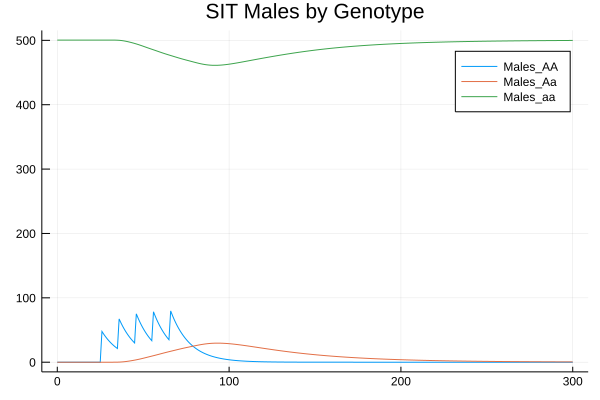

In [11]:
plot(sol_control.t, males_AA, label = "Males_AA", title = "SIT Males by Genotype")
plot!(sol_control.t, males_Aa, label = "Males_Aa")
plot!(sol_control.t, males_aa, label = "Males_aa")